<a href="https://colab.research.google.com/github/shubh2016shiv/Machine-Learning-Project-in-Finance-Domain/blob/main/Lending_Club_Dataset_ML_Assignment_EDA.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

## Downloading Lending Club Dataset in Colab

In [ ]:
!pip install --upgrade --q --no-cache-dir gdown

In [ ]:
!gdown 1PA2OMmdnptQ-mv81rCcKSirOJsBegH-8

Downloading...
From: https://drive.google.com/uc?id=1PA2OMmdnptQ-mv81rCcKSirOJsBegH-8
To: /content/Loan_status_2007-2020Q3.gzip
100% 1.77G/1.77G [00:17<00:00, 98.8MB/s]


## Exploratory Data Analysis

### Read Loan Data into Dataframe

In [ ]:
import pandas as pd # Pandas library for manipulating dataframe
import numpy as np # Numpy for manipulating matrix or arrays
from scipy.stats import chi2_contingency # Scipy library for creating contingency table for chi2 testing
from itertools import combinations # Combination class

# Visualization Libraries
from matplotlib import pyplot as plt 
import plotly.express as px
import plotly.graph_objects as go
import seaborn as sns
import warnings

# Set the warning configuration to ignore the warning in the notebook and set the seaborn configuration across the notebook
warnings.filterwarnings(action='ignore')
sns.set()

In [ ]:
# Configure pandas to display all the columns
pd.set_option('display.max_columns', None)

In [ ]:
# Read first 1 million rows from Loan Dataset into pandas dataframe with low_memory parameter set as True
"""
Setting the low_memory parameter as 'True' as the loan dataset is large dataset and might consume too much memory when loaded in RAM
and could result in notebook to crash. Hence, By setting low_memory=True, python program will be able to read 
and process the dataset more efficiently, without running out of memory.
"""
loan_data = pd.read_csv("/content/Loan_status_2007-2020Q3.gzip",low_memory=True,nrows=1000000)

In [ ]:
# Check the size of dataframe
loan_data.shape

(1000000, 142)

In [ ]:
# Check the first five rows of dataframe
loan_data.head()

,Unnamed: 0,id,loan_amnt,funded_amnt,funded_amnt_inv,term,int_rate,installment,grade,sub_grade,emp_title,emp_length,home_ownership,annual_inc,verification_status,issue_d,loan_status,pymnt_plan,url,purpose,title,zip_code,addr_state,dti,delinq_2yrs,earliest_cr_line,fico_range_low,fico_range_high,inq_last_6mths,mths_since_last_delinq,mths_since_last_record,open_acc,pub_rec,revol_bal,revol_util,total_acc,initial_list_status,out_prncp,out_prncp_inv,total_pymnt,total_pymnt_inv,total_rec_prncp,total_rec_int,total_rec_late_fee,recoveries,collection_recovery_fee,last_pymnt_d,last_pymnt_amnt,next_pymnt_d,last_credit_pull_d,last_fico_range_high,last_fico_range_low,collections_12_mths_ex_med,mths_since_last_major_derog,policy_code,application_type,annual_inc_joint,dti_joint,verification_status_joint,acc_now_delinq,tot_coll_amt,tot_cur_bal,open_acc_6m,open_act_il,open_il_12m,open_il_24m,mths_since_rcnt_il,total_bal_il,il_util,open_rv_12m,open_rv_24m,max_bal_bc,all_util,total_rev_hi_lim,inq_fi,total_cu_tl,inq_last_12m,acc_open_past_24mths,avg_cur_bal,bc_open_to_buy,bc_util,chargeoff_within_12_mths,delinq_amnt,mo_sin_old_il_acct,mo_sin_old_rev_tl_op,mo_sin_rcnt_rev_tl_op,mo_sin_rcnt_tl,mort_acc,mths_since_recent_bc,mths_since_recent_bc_dlq,mths_since_recent_inq,mths_since_recent_revol_delinq,num_accts_ever_120_pd,num_actv_bc_tl,num_actv_rev_tl,num_bc_sats,num_bc_tl,num_il_tl,num_op_rev_tl,num_rev_accts,num_rev_tl_bal_gt_0,num_sats,num_tl_120dpd_2m,num_tl_30dpd,num_tl_90g_dpd_24m,num_tl_op_past_12m,pct_tl_nvr_dlq,percent_bc_gt_75,pub_rec_bankruptcies,tax_liens,tot_hi_cred_lim,total_bal_ex_mort,total_bc_limit,total_il_high_credit_limit,revol_bal_joint,sec_app_fico_range_low,sec_app_fico_range_high,sec_app_earliest_cr_line,sec_app_inq_last_6mths,sec_app_mort_acc,sec_app_open_acc,sec_app_revol_util,sec_app_open_act_il,sec_app_num_rev_accts,sec_app_chargeoff_within_12_mths,sec_app_collections_12_mths_ex_med,hardship_flag,hardship_type,hardship_reason,hardship_status,deferral_term,hardship_amount,hardship_start_date,hardship_end_date,payment_plan_start_date,hardship_length,hardship_dpd,hardship_loan_status,orig_projected_additional_accrued_interest,hardship_payoff_balance_amount,hardship_last_payment_amount,debt_settlement_flag
0,0,1077501,5000.0,5000.0,4975.0,36 months,10.65%,162.87,B,B2,NaN,10+ years,RENT,24000.0,Verified,Dec-2011,Fully Paid,n,https://lendingclub.com/browse/loanDetail.acti...,credit_card,Computer,860xx,AZ,27.65,0.0,Jan-1985,735.0,739.0,1.0,NaN,NaN,3.0,0.0,13648.0,83.7%,9.0,f,0.0,0.0,5863.155187,5833.84,5000.00,863.16,0.00,0.0,0.00,Jan-2015,171.62,NaN,May-2020,704.0,700.0,0.0,NaN,1.0,Individual,NaN,NaN,NaN,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.0,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.0,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,N,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,N
1,1,1077430,2500.0,2500.0,2500.0,60 months,15.27%,59.83,C,C4,Ryder,< 1 year,RENT,30000.0,Source Verified,Dec-2011,Charged Off,n,https://lendingclub.com/browse/loanDetail.acti...,car,bike,309xx,GA,1.00,0.0,Apr-1999,740.0,744.0,5.0,NaN,NaN,3.0,0.0,1687.0,9.4%,4.0,f,0.0,0.0,1014.530000,1014.53,456.46,435.17,0.00,122.9,1.11,Apr-2013,119.66,NaN,Oct-2016,499.0,0.0,0.0,NaN,1.0,Individual,NaN,NaN,NaN,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.0,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.0,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,N,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,N
2,2,1077175,2400.0,2400.0,2400.0,36 months,15.96%,84.33,C,C5,NaN,10+ years,RENT,12252.0,Not Verified,Dec-2011,Fully Paid,n,https://lendingclub.com/browse/loanDetail.acti...,small_business,real estate business,606xx,IL,8.72,0.0,Nov-2001,735.0,739.0,2.0,NaN,NaN,2.0,0.0,2956.0,98.5%,10.0,f,0.0,0.0,3

### Univariate Exploratory Data Analysis

#### PART A: Exploring Data Type of each column

In [ ]:
# check the types of each attribute
dtype_df = pd.DataFrame.from_dict(dict(loan_data.dtypes.sort_values()),orient='index').reset_index()
dtype_df.columns = ["Column","Data Type"]

In [ ]:
# Sort the data type dataframe in ascending order 
dtype_df = dtype_df.sort_values(by="Data Type")

In [ ]:
dtype_df.to_csv("columns and their datatype.csv",index=False)

In [ ]:
dtype_df.head()

,Column,Data Type
0,Unnamed: 0,int64
79,fico_range_low,float64
78,open_il_24m,float64
77,inq_last_6mths,float64
76,mths_since_last_delinq,float64


Text(0.5, 1.0, 'Count of each Data Type in Loan Dataset')

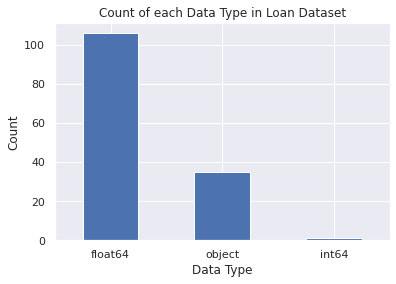

In [ ]:
# Plot the count of each datatype category in descending order 
dtype_df['Data Type'].value_counts().plot(kind='bar', xlabel='Data Type', ylabel='Count', rot=0)
plt.title("Count of each Data Type in Loan Dataset")

In [ ]:
# Show the count of each datatype category
dtype_df['Data Type'].value_counts()

float64    106
object      35
int64        1
Name: Data Type, dtype: int64

#### PART B: Exploring important columns

###### Loan Amount

In [ ]:
# Show the statistics of Loan Amount
loan_data['loan_amnt'].describe()

count    999999.000000
mean      15262.006087
std        9670.232208
min         500.000000
25%        8000.000000
50%       12600.000000
75%       20000.000000
max       40000.000000
Name: loan_amnt, dtype: float64

In [ ]:
# create 10 bins for loan_amnt_range
loan_bin = loan_data['loan_amnt'].value_counts(bins=10).sort_values()
loan_bin

(36050.0, 40000.0]     32450
(32100.0, 36050.0]     43899
(28150.0, 32100.0]     48507
(20250.0, 24200.0]     56914
(24200.0, 28150.0]     59575
(460.499, 4450.0]      88601
(16300.0, 20250.0]    120406
(12350.0, 16300.0]    142516
(4450.0, 8400.0]      189169
(8400.0, 12350.0]     217962
Name: loan_amnt, dtype: int64

In [ ]:
# label with the round up numbers
loan_data['loan_amnt_range'] = pd.cut(loan_data['loan_amnt'], bins=10, 
                                      labels=['460-4450', '4450-8400', '8400-12350',
                                              '12350-16300','16300-20250','20250-24200',
                                              '24200-28150','28150-32100','32100-36050',
                                              '36050-40000'])

Text(0.5, 1.0, 'Loan amount range (USD)')

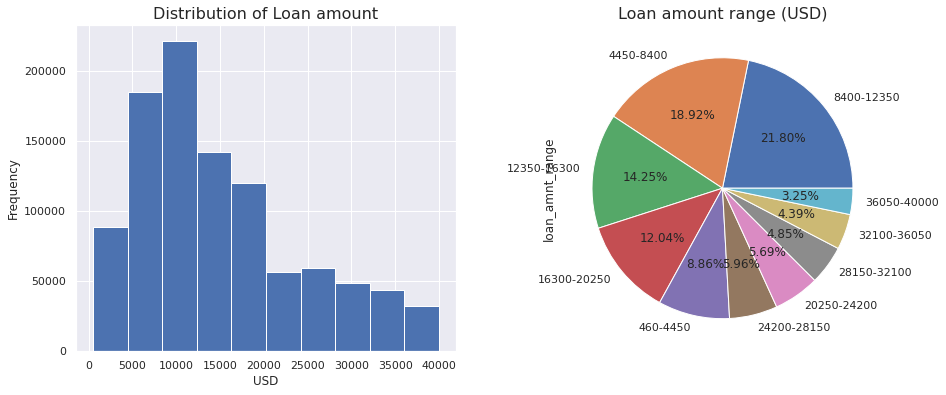

In [ ]:
# Visualizing Loan Amount
fig, axs = plt.subplots(1, 2, figsize=(15, 6))

# distribution of loan amount
loan_data['loan_amnt'].hist(bins=10,ax=axs[0])
axs[0].set_title('Distribution of Loan amount', fontsize=16)
axs[0].set_ylabel("Frequency")
axs[0].set_xlabel("USD")

# pie chart with the same loan mount ranges
loan_data['loan_amnt_range'].value_counts().plot.pie(ax=axs[1], autopct='%.2f%%')
axs[1].set_title('Loan amount range (USD)', fontsize=16)

In [ ]:
# Show the proportion of each loan amount range
loan_data['loan_amnt_range'].value_counts(normalize=True)

8400-12350     0.217962
4450-8400      0.189169
12350-16300    0.142516
16300-20250    0.120406
460-4450       0.088601
24200-28150    0.059575
20250-24200    0.056914
28150-32100    0.048507
32100-36050    0.043899
36050-40000    0.032450
Name: loan_amnt_range, dtype: float64

###### Interest Rates

In [ ]:
# Show the statistics of Interest Rates
loan_data['int_rate'].describe()

count      999999
unique        575
top        11.99%
freq        23843
Name: int_rate, dtype: object

In [ ]:
# remove '%' and convert 'interest' into numeric type
loan_data['int_rate'] = loan_data['int_rate'].str.replace('%','')
loan_data['int_rate'] = pd.to_numeric(loan_data['int_rate'])
loan_data['int_rate'].head()

0    10.65
1    15.27
2    15.96
3    13.49
4    12.69
Name: int_rate, dtype: float64

In [ ]:
# create bins for int_rate_range, based on https://www.lendingclub.com/foliofn/rateDetail.action
int_bin = loan_data['int_rate'].value_counts(bins=5).sort_values(ascending=True)
int_bin

(25.854, 30.99]                  18710
(20.718, 25.854]                 61242
(15.582, 20.718]                197390
(5.2829999999999995, 10.446]    343137
(10.446, 15.582]                379520
Name: int_rate, dtype: int64

In [ ]:
# labels with rounded figures 
loan_data['int_rate_range'] = pd.cut(loan_data['int_rate'],bins=5,labels=['5.2-10.4','10.4-15.6','15.6-20.7','20.7-25.8','25.8-31'])

Text(0.5, 1.0, 'Interest rate range')

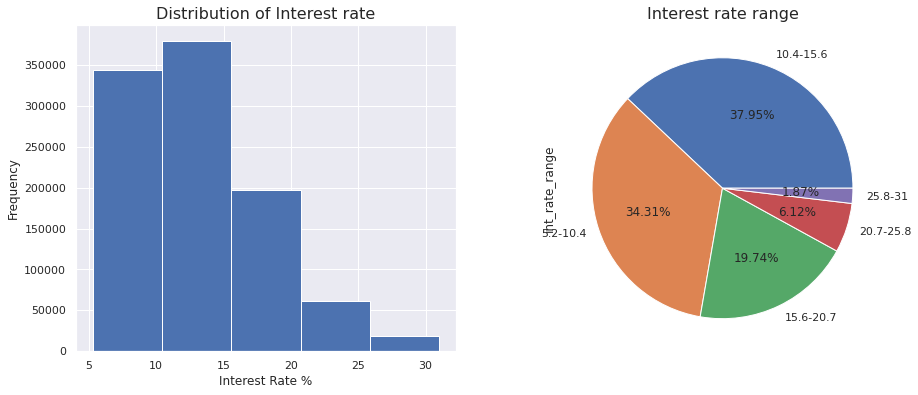

In [ ]:
# Visualize Interest Rate
fig, axs = plt.subplots(1, 2, figsize=(15, 6))

# histogram
loan_data['int_rate'].hist(bins=5, ax=axs[0])
axs[0].set_title('Distribution of Interest rate', fontsize=16)
axs[0].set_ylabel("Frequency")
axs[0].set_xlabel("Interest Rate %")

# pie chart
loan_data['int_rate_range'].value_counts().plot.pie(ax=axs[1], autopct='%.2f%%')
axs[1].set_title('Interest rate range', fontsize=16)

In [ ]:
# Show the proportion of each Interest Rate range
loan_data['int_rate_range'].value_counts(normalize=True)

10.4-15.6    0.379520
5.2-10.4     0.343137
15.6-20.7    0.197390
20.7-25.8    0.061242
25.8-31      0.018710
Name: int_rate_range, dtype: float64

##### FICO Scores

In [ ]:
# average of FICO scores
loan_data['FICO_average'] = (loan_data['fico_range_high']+loan_data['fico_range_low'])/2
loan_data['FICO_average'].head()

0    737.0
1    742.0
2    737.0
3    692.0
4    697.0
Name: FICO_average, dtype: float64

In [ ]:
# Show the statistics of average FICO scores
loan_data['FICO_average'].describe()

count    999999.000000
mean        706.023471
std          35.022187
min         612.000000
25%         677.000000
50%         697.000000
75%         727.000000
max         847.500000
Name: FICO_average, dtype: float64

In [ ]:
# convert FICO scores into categories by assigning categories as 'Poor', 'Fair', 'Good', 'Very_good', 'Exceptional'

## conditions
conditions = [(loan_data['FICO_average']<580),
    (loan_data['FICO_average']>580) & (loan_data['FICO_average']<=669),
    (loan_data['FICO_average']>669) & (loan_data['FICO_average']<=739),
    (loan_data['FICO_average']>739) & (loan_data['FICO_average']<=799),
    (loan_data['FICO_average']>=800)]

## categories
rating = ['Poor', 'Fair', 'Good', 'Very_good', 'Exceptional']

## return an array drawn from 2 lists, and add the new column to df
loan_data['FICO_rating'] = np.select(conditions, rating)

Text(0.5, 1.0, 'FICO scores by range')

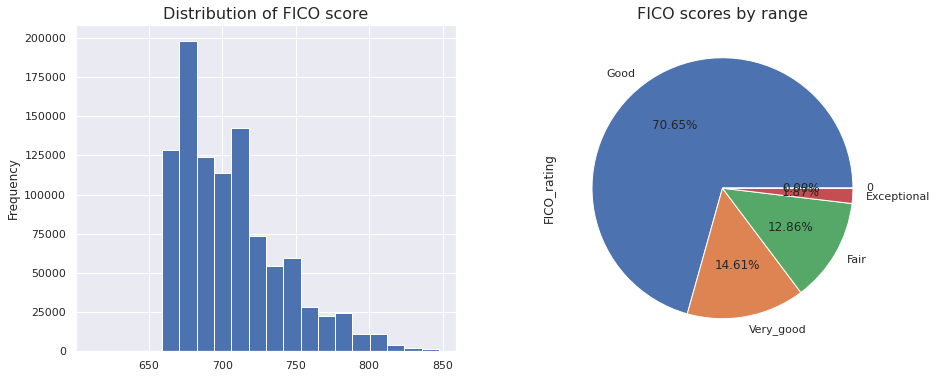

In [ ]:
# Distribution 
fig, axs = plt.subplots(1, 2, figsize=(15, 6))

# histogram
loan_data['FICO_average'].hist(bins=20, ax=axs[0], figsize=(15, 6))
axs[0].set_title('Distribution of FICO score', fontsize=16)
axs[0].set_ylabel('Frequency')

# pie chart
loan_data['FICO_rating'].value_counts().plot.pie(ax=axs[1], autopct='%.2f%%')
axs[1].set_title('FICO scores by range', fontsize=16)

In [ ]:
# Show the proportion of each FICO rating range
loan_data['FICO_rating'].value_counts(normalize=True)

Good           0.706533
Very_good      0.146097
Fair           0.128629
Exceptional    0.018740
0              0.000001
Name: FICO_rating, dtype: float64

##### Loan Purpose and Term

Text(0.5, 1.0, 'Loan term')

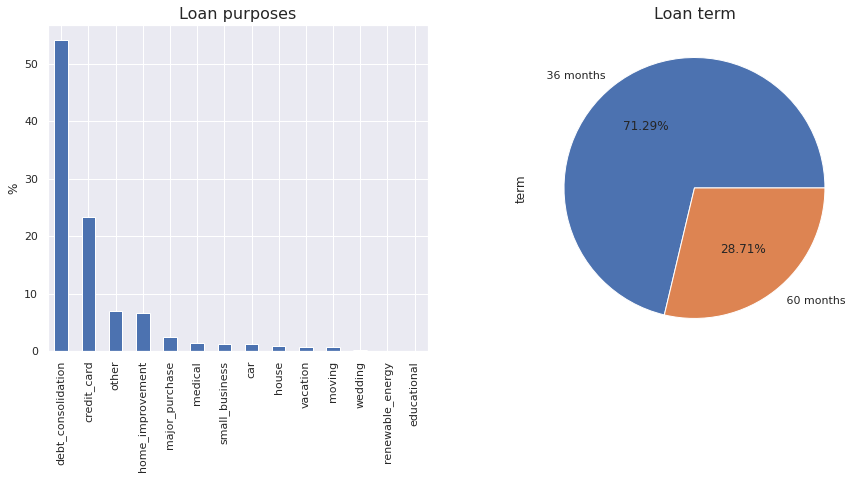

In [ ]:
# Visualize Loan Purpose and Loan Term
fig, axs = plt.subplots(1,2 , figsize=(15, 6))
# bar chart
loan_data['purpose'].value_counts(normalize=True).mul(100).plot.bar(ax=axs[0])
axs[0].set_title('Loan purposes', fontsize=16)
axs[0].set_ylabel("%")

# pie chart
loan_data['term'].value_counts().plot.pie(ax=axs[1], autopct='%.2f%%')
axs[1].set_title('Loan term', fontsize=16)

In [ ]:
# Show the proportion of Loan Purpose
loan_data['purpose'].value_counts(normalize=True)

debt_consolidation    0.540549
credit_card           0.234084
other                 0.069956
home_improvement      0.066782
major_purchase        0.024529
medical               0.013172
small_business        0.012378
car                   0.011751
house                 0.009297
vacation              0.007120
moving                0.006948
wedding               0.002340
renewable_energy      0.000671
educational           0.000423
Name: purpose, dtype: float64

##### Grades and Subgrades

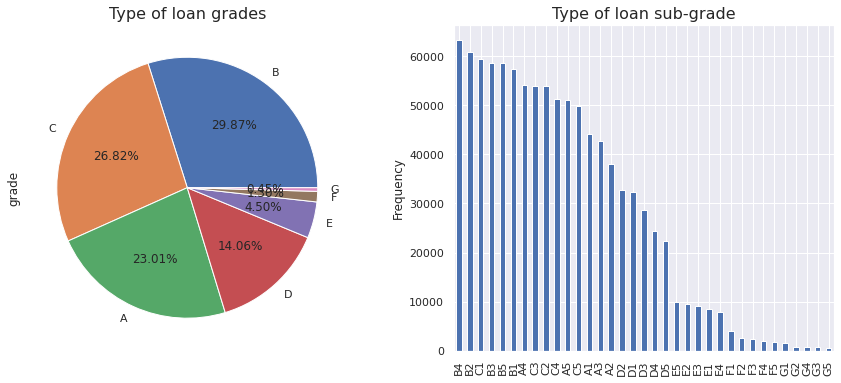

In [ ]:
# Visualize Loan Grade and Sub-Grade
fig, axs = plt.subplots(1, 2, figsize=(15, 6))
# grade
loan_data['grade'].value_counts().plot.pie(ax=axs[0], autopct='%.2f%%')
axs[0].set_title('Type of loan grades', fontsize=16)

# sub-grade
loan_data['sub_grade'].value_counts().plot.bar(ax=axs[1])
axs[1].set_title('Type of loan sub-grade', fontsize=16)
axs[1].set_ylabel('Frequency')
plt.show()

In [ ]:
# Create a crosstab of the data from 'sub_grade' column and 'grade' column
crosstab_grade_subgrade = pd.crosstab(loan_data['sub_grade'], loan_data['grade'])

fig = px.bar(crosstab_grade_subgrade)
fig.show()

##### Employment Length, Home Ownership, and verification status

Text(0, 0.5, '%')

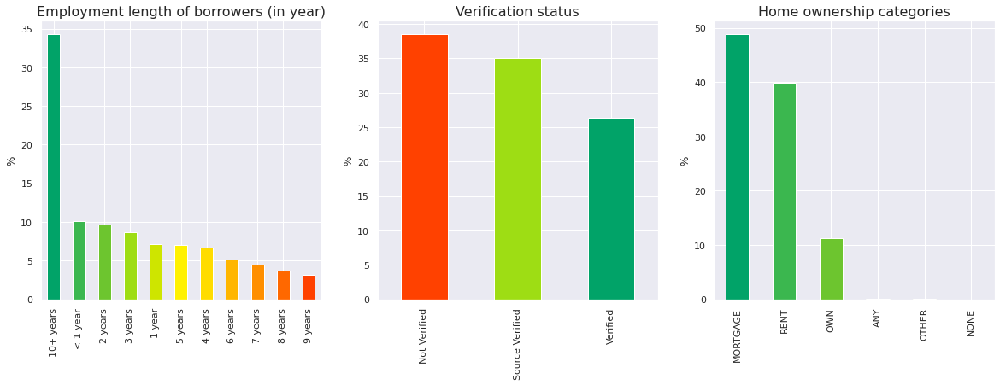

In [ ]:
fig, axs = plt.subplots(1, 3, figsize=(20, 6))

# employment length plot
loan_data['emp_length'].value_counts(normalize=True).mul(100).plot.bar(ax=axs[0],
                                                                       color=['#01A368', '#3BB74F',
                                                                              '#6DC52F', '#9EDD14',
                                                                              '#CEE500', '#FFF100',
                                                                              '#FFDC00', '#FFB600',
                                                                              '#FF8F00', '#FF6800',
                                                                              '#FF4100'])

axs[0].set_title('Employment length of borrowers (in year)', fontsize=16)
axs[0].set_ylabel("%")

# verification status plot
loan_data['verification_status'].value_counts(normalize=True).mul(100).plot.bar(ax=axs[1],
                                                                                color=['#FF4100','#9EDD14','#01A368'])
axs[1].set_title('Verification status', fontsize=16)
axs[1].set_ylabel("%")

# Home ownership plot
loan_data['home_ownership'].value_counts(normalize=True).mul(100).plot.bar(ax=axs[2],
                                                                           color=['#01A368', '#3BB74F',
                                                                                 '#6DC52F', '#9EDD14',
                                                                                 '#CEE500', '#FFF100'])
axs[2].set_title('Home ownership categories', fontsize=16)
axs[2].set_ylabel("%")

# all the units ae percentage

##### Loan Status and Application Types

Text(0.5, 1.0, 'Application type')

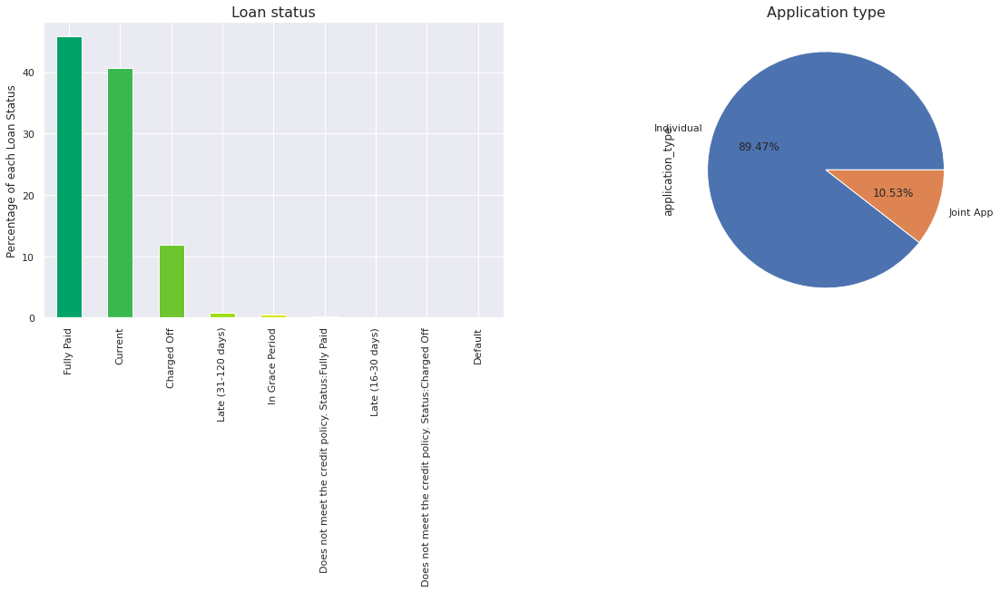

In [ ]:
# the graphs for "loan status" and "application type" are plotted below
fig, axs = plt.subplots(1, 2, figsize=(20, 6))

# 1st graphs
loan_data['loan_status'].value_counts(normalize=True).mul(100).plot.bar(ax=axs[0],color=['#01A368', '#3BB74F',
                                                                              '#6DC52F', '#9EDD14',
                                                                              '#CEE500', '#FFF100',
                                                                              '#FFDC00', '#FFB600',
                                                                              '#FF8F00'])
axs[0].set_title('Loan status', fontsize=16)
axs[0].set_ylabel("Percentage of each Loan Status")

# 2nd graph
loan_data['application_type'].value_counts().plot.pie(ax=axs[1],autopct='%.2f%%')
axs[1].set_title('Application type', fontsize=16)

#### PART C: Analysing Missing Values

In [ ]:
# Helper Function to calculate the percentage of missing values in each column of the dataframe
def calculate_null_values_perc(data, columns):
        null_values_df = pd.DataFrame(data[columns].isna().sum()).reset_index()
        null_values_df.columns = ['Column', 'Number of Null Values']
        null_values_df['Null Values Percent'] = (null_values_df[
                                                     'Number of Null Values'] / len(data)) * 100
        null_values_df.sort_values(by='Null Values Percent', ascending=False, inplace=True)
        return null_values_df

In [ ]:
# Get the percentage and number of missing values in dataframe
null_values_df = calculate_null_values_perc(loan_data,loan_data.columns)

In [ ]:
# Show the first five rowd of the percentage and number of missing values in dataframe
null_values_df.head()

,Column,Number of Null Values,Null Values Percent
137,hardship_loan_status,942542,94.2542
128,hardship_reason,942460,94.2460
129,hardship_status,942458,94.2458
136,hardship_dpd,942456,94.2456
135,hardship_length,942456,94.2456


In [ ]:
# Visualize the percentage of missing values in each column in descending order using plotly 
# Set the data to be plotted
data = list(null_values_df["Null Values Percent"].values)

# Set the labels for the data
labels = list(null_values_df["Column"].values)

# Sort the data and labels in descending order
data, labels = zip(*sorted(zip(data, labels), reverse=False))

# Create the figure object
fig = go.Figure(data=[go.Bar(x=data, y=labels, orientation='h')])

# Set the title and axis labels
fig.update_layout(title_text='Percentage of Missing Values in each column',
                  xaxis_title='Percentage of Missing Values',
                  yaxis_title='Columns')

# Display the plot
fig.show()

In [ ]:
# Columns which have more than 80% missing values
'''
As observed below, most of the missing values are present in hardship related columns and secondary application related columns
'''
na_values = loan_data.isnull().mean()
na_values[na_values>0.8]

mths_since_last_record                        0.875440
annual_inc_joint                              0.894748
dti_joint                                     0.894748
verification_status_joint                     0.900318
mths_since_recent_bc_dlq                      0.805101
revol_bal_joint                               0.894749
sec_app_fico_range_low                        0.894748
sec_app_fico_range_high                       0.894748
sec_app_earliest_cr_line                      0.894748
sec_app_inq_last_6mths                        0.894748
sec_app_mort_acc                              0.894748
sec_app_open_acc                              0.894748
sec_app_revol_util                            0.896586
sec_app_open_act_il                           0.894748
sec_app_num_rev_accts                         0.894748
sec_app_chargeoff_within_12_mths              0.894748
sec_app_collections_12_mths_ex_med            0.894748
hardship_type                                 0.942456
hardship_r

### Bivariate Exploratory Data Analysis

##### Loan Status with Term

In [ ]:
# Visualize Loan Status with Term
crosstab_loanStatus_term = pd.crosstab(loan_data['loan_status'], loan_data['term'], normalize="index").mul(100)
fig = px.bar(crosstab_loanStatus_term,barmode='group')
fig.update_layout(
    title="Loan Status by Term",
    yaxis_title="Percentage"
)

fig.show()

##### Loan Status with Employment Length

In [ ]:
# visualize employment length by loan status
crosstab_empLen_loanStatus = pd.crosstab(loan_data['loan_status'], loan_data['emp_length'], normalize='index').mul(100)
fig = px.bar(crosstab_empLen_loanStatus,barmode='group')
fig.update_layout(
    title="Employment length by Loan status",
    yaxis_title="Percentage"
)

fig.show()

##### Loan Status and Interest Rates and Loan Amount

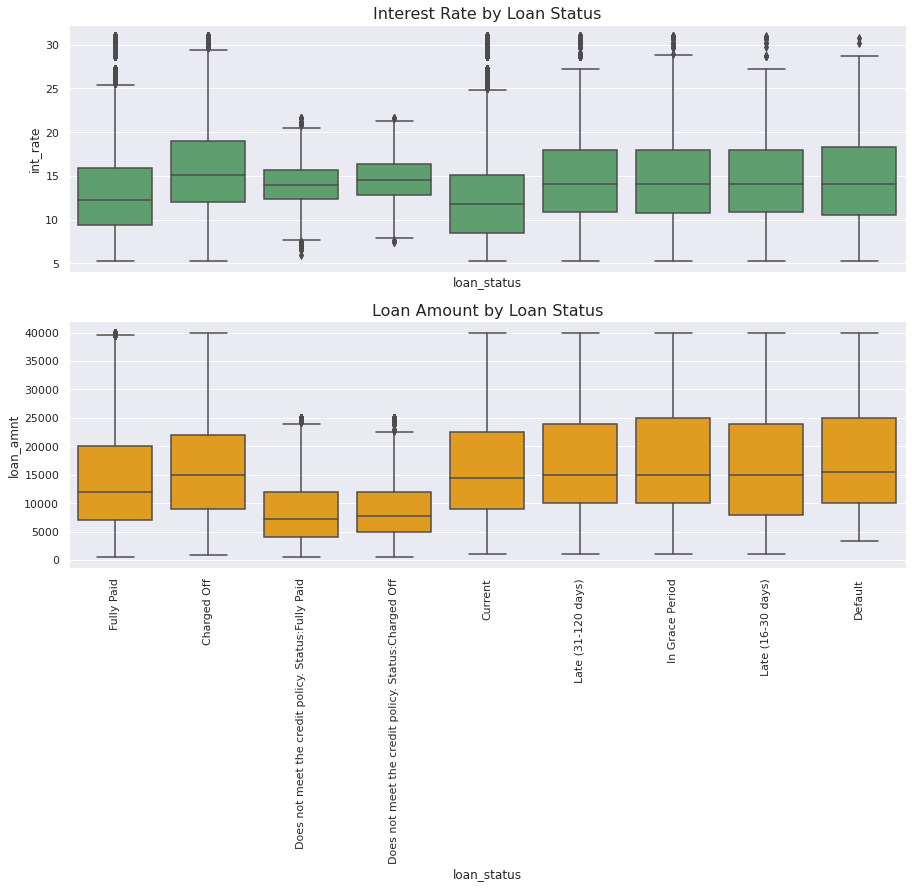

In [ ]:
# Visualize interest rate and loan amount by loan status
fig, axs = plt.subplots(2, 1, figsize=(15, 10), sharex=True)

# loan status and interest rate
sns.boxplot(x="loan_status", y="int_rate", data=loan_data, color='g', ax=axs[0])
axs[0].set_title('Interest Rate by Loan Status', fontsize=16)

# loan status and loan amount
sns.boxplot(x="loan_status", y="loan_amnt", data=loan_data, color='orange', ax=axs[1])
axs[1].set_title('Loan Amount by Loan Status', fontsize=16)
axs[1].tick_params(axis='x', rotation=90)

##### Loan Amount and Purpose

In [ ]:
# Visualize Loam Amount by each loan purpose
fig = px.box(loan_data, x="purpose", y="loan_amnt")
fig.update_layout(
    title="Loan amount distribution by purpose"
)
fig.show()

##### Interest Rates and Grades

In [ ]:
# Visualize Interest rate by each grade
fig = px.box(loan_data, x="grade", y="int_rate")
fig.update_layout(
    title="Interest rate distribution by Grade"
)
fig.show()

### Correlation Analysis

#### Correlation between Numerical Columns (using Pearson's correlation coefficient)

In [ ]:
# Select the numerical columns in the dataframe
numerical_columns = loan_data.select_dtypes(include=['int','float']).columns

In [ ]:
# SHow the selected numerical columns
numerical_columns.values

array(['Unnamed: 0', 'loan_amnt', 'funded_amnt', 'funded_amnt_inv',
       'int_rate', 'installment', 'annual_inc', 'dti', 'delinq_2yrs',
       'fico_range_low', 'fico_range_high', 'inq_last_6mths',
       'mths_since_last_delinq', 'mths_since_last_record', 'open_acc',
       'pub_rec', 'revol_bal', 'total_acc', 'out_prncp', 'out_prncp_inv',
       'total_pymnt', 'total_pymnt_inv', 'total_rec_prncp',
       'total_rec_int', 'total_rec_late_fee', 'recoveries',
       'collection_recovery_fee', 'last_pymnt_amnt',
       'last_fico_range_high', 'last_fico_range_low',
       'collections_12_mths_ex_med', 'mths_since_last_major_derog',
       'policy_code', 'annual_inc_joint', 'dti_joint', 'acc_now_delinq',
       'tot_coll_amt', 'tot_cur_bal', 'open_acc_6m', 'open_act_il',
       'open_il_12m', 'open_il_24m', 'mths_since_rcnt_il', 'total_bal_il',
       'il_util', 'open_rv_12m', 'open_rv_24m', 'max_bal_bc', 'all_util',
       'total_rev_hi_lim', 'inq_fi', 'total_cu_tl', 'inq_last_12m',
  

In [ ]:
# Selecting the 10 important numerical columns for correlation based on Borrower's financial situation
selected_numerical_columns = [
    'loan_amnt', # The requested loan amount
    'funded_amnt', #  The amount of the loan that was funded
    'int_rate', # The interest rate of the loan
    'installment', # The monthly payment owed by the borrower
    'annual_inc', # The borrower's annual income
    'dti', # The borrower's debt-to-income ratio
    'delinq_2yrs', # The number of 30+ days past-due incidences of delinquency in the borrower's credit file for the past 2 years
    'FICO_average', # borrower's average FICO credit score
    'open_acc', # The number of open credit lines in the borrower's credit file
    'revol_bal' # The borrower's credit card debt
]

In [ ]:
# Filter the specified numerical columns from the original loan data
loan_data_numerical_subset_df = loan_data[selected_numerical_columns]

In [ ]:
# Find the correlation between numerical columns
correlation_between_numerical_cols = loan_data_numerical_subset_df.corr()

In [ ]:
# Show the correlation heatmap between numeerical columns
fig = px.imshow(correlation_between_numerical_cols, color_continuous_scale='RdBu_r', origin='lower', text_auto=True, aspect="auto")
fig.show()

#### Correlation between Categorical Columns (using Chi-Squared Testing)

In [ ]:
# Select the categorical columns in the dataframe
categorical_columns = loan_data.select_dtypes(include='object').columns

In [ ]:
# SHow the selected categorical columns
categorical_columns

Index(['id', 'term', 'grade', 'sub_grade', 'emp_title', 'emp_length',
       'home_ownership', 'verification_status', 'issue_d', 'loan_status',
       'pymnt_plan', 'url', 'purpose', 'title', 'zip_code', 'addr_state',
       'earliest_cr_line', 'revol_util', 'initial_list_status', 'last_pymnt_d',
       'next_pymnt_d', 'last_credit_pull_d', 'application_type',
       'verification_status_joint', 'sec_app_earliest_cr_line',
       'hardship_flag', 'hardship_type', 'hardship_reason', 'hardship_status',
       'hardship_start_date', 'hardship_end_date', 'payment_plan_start_date',
       'hardship_loan_status', 'debt_settlement_flag', 'FICO_rating'],
      dtype='object')

In [ ]:
# Select the important categorical columns
selected_categorical_columns = [
    'term', 'grade', 'sub_grade',
    'emp_length','home_ownership', 'verification_status',
    'purpose','addr_state','application_type',
    'hardship_flag', 'hardship_type', 'hardship_status',
    'hardship_loan_status', 'debt_settlement_flag', 'FICO_rating'
]

In [ ]:
# Filter the dataframe based on selected categorical columns
loan_data_categorical_subset_df = loan_data[selected_categorical_columns]

In [ ]:
'''
Perform the chi2 test for association for determining the correlation between categorical columns
'''
# Create a list to store the results of the chi-squared tests
chi2_results = []

# Loop through each combination of columns
for col1, col2 in combinations(selected_categorical_columns, 2):
  # Create a contingency table for the two columns
  cont_table = pd.crosstab(loan_data_categorical_subset_df[col1], loan_data_categorical_subset_df[col2])
  
  # Perform the chi-squared test
  chi2, p, dof, expected = chi2_contingency(cont_table)
  
  # Store the results in a list
  chi2_results.append({
      'column 1': col1,
      'column 2': col2,
      'chi2_value': chi2,
      'p_value': p
  })

# Convert the list of results to a DataFrame
chi2_results_df = pd.DataFrame(chi2_results)

In [ ]:
# Show the categorical columns correlation heatmap using chi-square statistics
fig = px.imshow(chi2_results_df.pivot(index='column 1', columns='column 2', values='chi2_value'), color_continuous_scale='RdBu_r', origin='equal', text_auto=True, aspect="auto")
fig.show()